In [1]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from datetime import datetime
import warnings

In [2]:
warnings.filterwarnings("ignore")

In [3]:
data = pd.read_csv("~\Desktop\JOTFORM\Summer2023\Anomaly-Detection\data\grouped_data.csv", index_col="date", parse_dates=True, squeeze=True)
industries = pd.read_csv("~\Desktop\JOTFORM\Summer2023\Anomaly-Detection\data\industry_data.csv")

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 6902 entries, 2023-01-01 to 2023-07-22
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   6902 non-null   int64 
 1   cluster      6902 non-null   object
 2   keyword_sum  6902 non-null   int64 
dtypes: int64(2), object(1)
memory usage: 215.7+ KB


In [5]:
data = data.drop(columns= "Unnamed: 0")

In [6]:
industries.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34 entries, 0 to 33
Data columns (total 1 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   industry  34 non-null     object
dtypes: object(1)
memory usage: 400.0+ bytes


In [7]:
df_list = []

In [8]:
for cluster in industries["industry"]:
    cluster_data = data[data['cluster'] == cluster]
    print(cluster)
    df_list.append(cluster_data)

accommodation
advertising, marketing & research
agriculture, farm animals & forestry
animal care & products for animals
arts & design
automotive
beauty & personal care
construction
consulting
e-commerce & retail trade
education
energy
engineering & architecture
entertainment & recreation
event organization
fashion
finance
food & beverages
health care and social assistance
home care & home services
human resources
information technology
insurance
legal
manufacturing
media & social networks
non-profit organizations
public administration
real estate & leasing
sports & activities
telecommunications
transportation
video & photography
warehousing, storage & delivery


In [9]:
len(df_list)

34

In [10]:
idx = pd.IndexSlice

In [11]:
start_date = datetime(2023,1,1)
end_date = datetime(2023,7,22)

In [12]:
from adtk.data import validate_series

In [13]:
updated_df_list = []

In [14]:
for df in df_list:
    updated_df = validate_series(df)
    updated_df_list.append(updated_df)

#### Control Charts

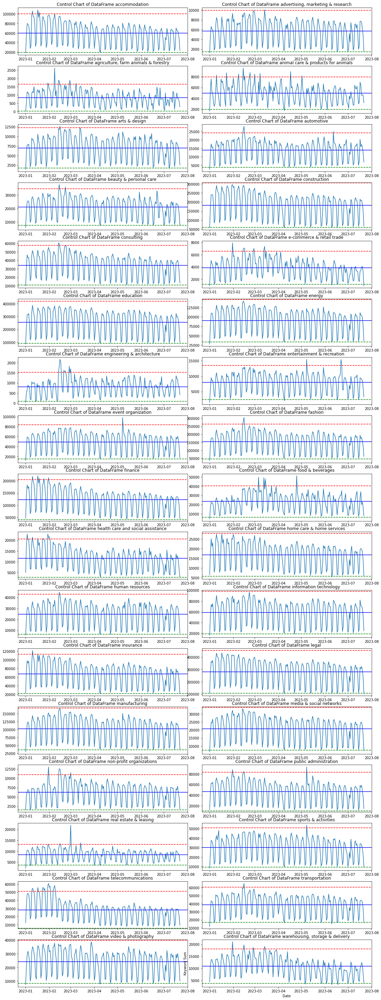

In [15]:
fig, axs = plt.subplots(17, 2, figsize=(15, 40))
fig.tight_layout()

for i, ax_row in enumerate(axs):
    for j, ax in enumerate(ax_row):
        index = i * 2 + j
        if index < len(updated_df_list):
            df = updated_df_list[index]
            mean = df['keyword_sum'].mean()
            std = df['keyword_sum'].std()

            upper_control_limit = mean + 1.75* std
            lower_control_limit = mean - 1.75 * std

            ax.plot(df.index, df['keyword_sum'], label='Veri')
            ax.axhline(upper_control_limit, color='r', linestyle='--', label='Üst Kontrol Limiti')
            ax.axhline(lower_control_limit, color='g', linestyle='--', label='Alt Kontrol Limiti')
            ax.axhline(mean, color='b', linestyle='-', label='Ortalama')
            plt.xlabel('Date')
            plt.ylabel('Keyword Sum')
            #ax.plot(df['keyword_sum'])  # Örnek olarak x ve y sütunlarını kullanarak bir plot çizimi
            cluster = df["cluster"].unique()
            ax.set_title(f'Control Chart of DataFrame {cluster[0]}')
        else:
            ax.axis('off')  # Eğer dataframe kalmadıysa, bu hücreyi boş bırak

plt.show()

In [16]:
df_list = []

#### WeekDay and Weekend amounts

In [17]:
for u_df in updated_df_list:
    u_df['DateTime'] = u_df.index
    u_df['DayOfTheWeek'] = u_df['DateTime'].dt.dayofweek
    u_df['WeekDay'] = (u_df['DayOfTheWeek'] < 5).astype(int)
    u_df['time_epoch'] = (u_df['DateTime'].astype(np.int64)/100000000000).astype(np.int64)
    u_df = u_df.drop(columns= "DateTime")
    df_list.append(u_df)

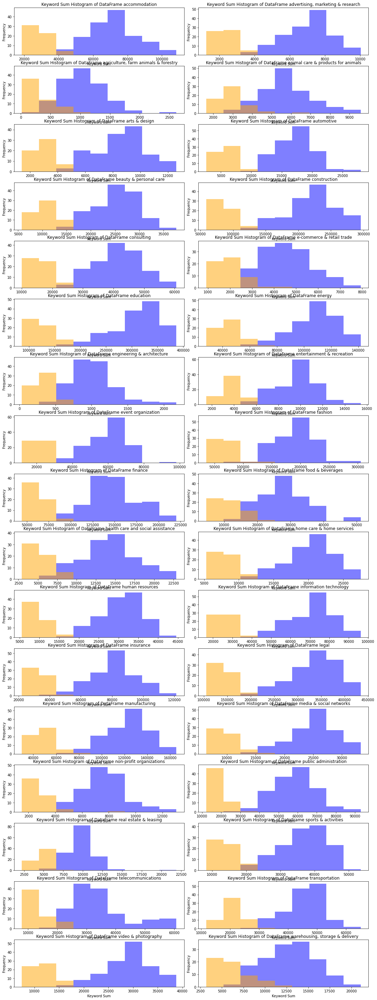

In [18]:
fig, axs = plt.subplots(17, 2, figsize=(15, 40))
fig.tight_layout()

for i, ax_row in enumerate(axs):
    for j, ax in enumerate(ax_row):
        index = i * 2 + j
        if index < len(df_list):
            df = df_list[index]

            weekend_values = df.loc[df['WeekDay'] == 0, 'keyword_sum']
            weekday_values = df.loc[df['WeekDay'] == 1, 'keyword_sum']

            weekend_heights, weekend_bins = np.histogram(weekend_values)
            weekday_heights, weekday_bins = np.histogram(weekday_values, bins=weekend_bins)

            width = (weekend_bins[1] - weekend_bins[0]) / 2
            bin_edges = np.linspace(min(df['keyword_sum']), max(df['keyword_sum']), 10)

            ax.hist(weekday_values, bins=bin_edges, alpha=0.5, color='blue', label='WeekDay')
            ax.hist(weekend_values, bins=bin_edges, alpha=0.5, color='orange', label='Weekend')

            ax.set_xlabel('Keyword Sum')
            ax.set_ylabel('Frequency')

            cluster = df["cluster"].unique()
            ax.set_title(f'Keyword Sum Histogram of DataFrame {cluster[0]}')
        else:
            ax.axis('off')  # Eğer dataframe kalmadıysa, bu hücreyi boş bırak

plt.show()

## ANOMALY DETECTION

1) adtk <br>
2) Isolation Forest <br>
3) Gaussian <br>
4) Markov <br>
5) Clustering

## adtk

In [19]:
from adtk.visualization import plot

accommodation
advertising, marketing & research
agriculture, farm animals & forestry
animal care & products for animals
arts & design
automotive
beauty & personal care
construction
consulting
e-commerce & retail trade
education
energy
engineering & architecture
entertainment & recreation
event organization
fashion
finance
food & beverages
health care and social assistance
home care & home services
human resources
information technology
insurance
legal
manufacturing
media & social networks
non-profit organizations
public administration
real estate & leasing
sports & activities
telecommunications
transportation
video & photography
warehousing, storage & delivery


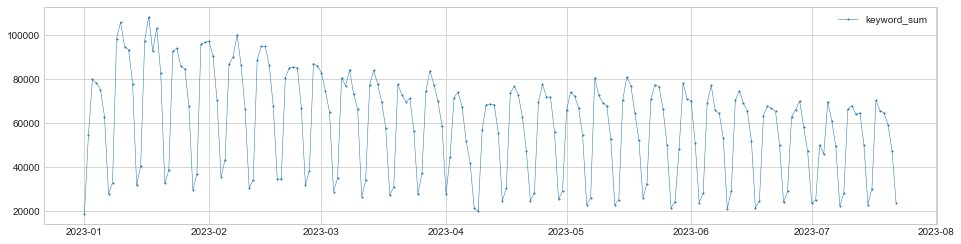

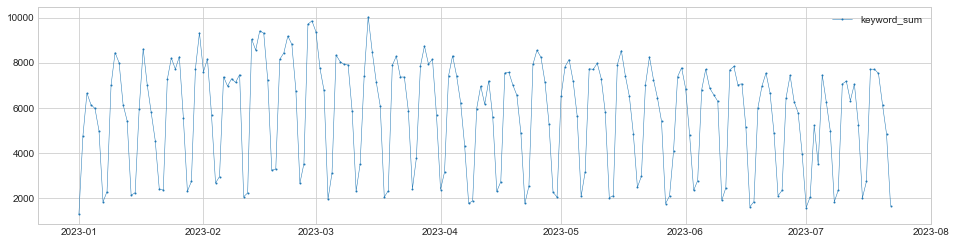

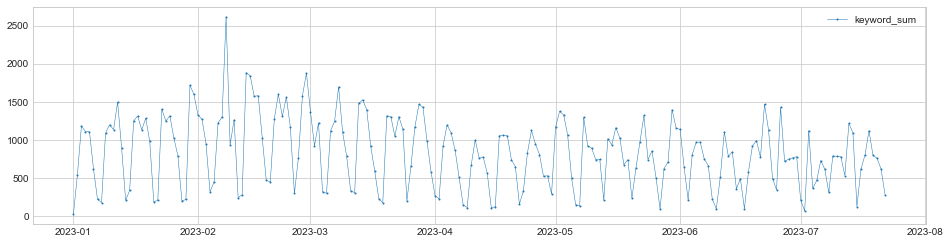

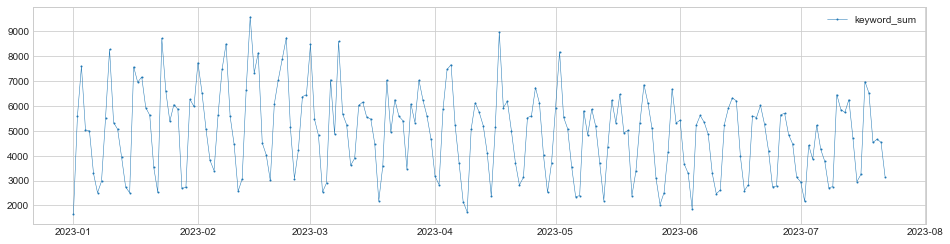

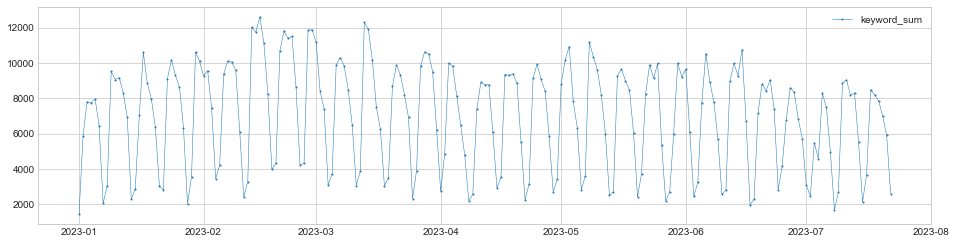

...

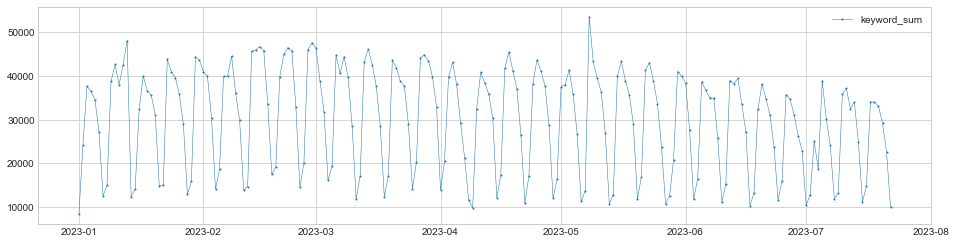

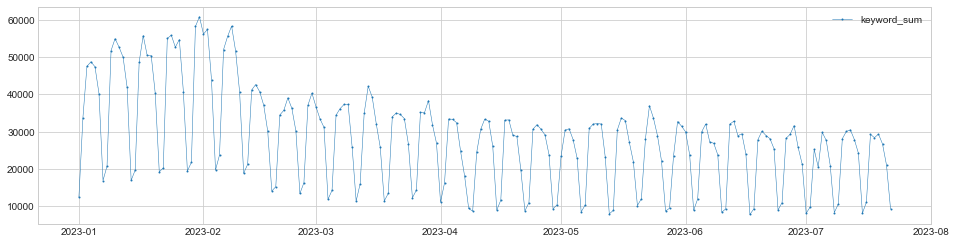

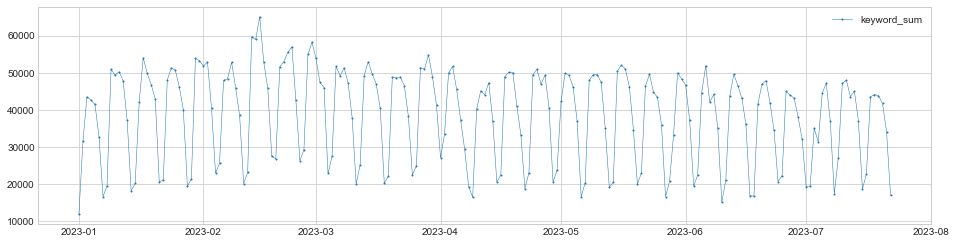

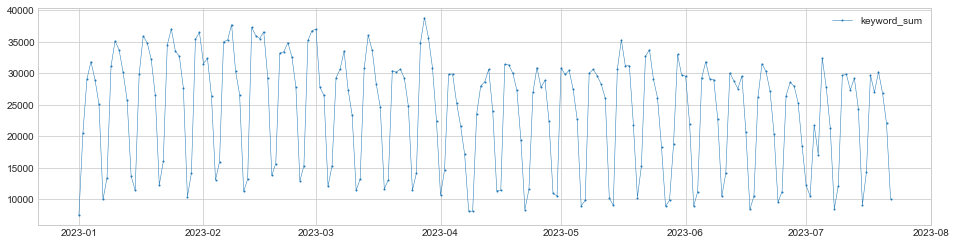

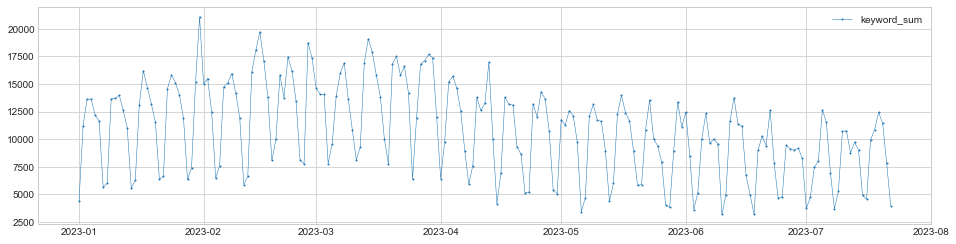

In [20]:
for new_df in df_list:
    cluster = new_df["cluster"].unique()
    print(cluster[0])
    plot(new_df["keyword_sum"])

#### Threshold

In [21]:
from adtk.detector import ThresholdAD

In [22]:
anomalies_threshold = []

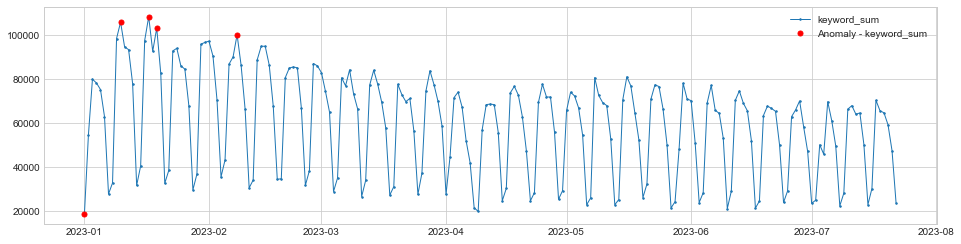

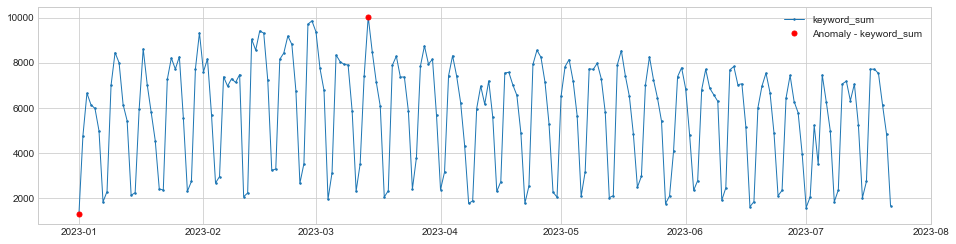

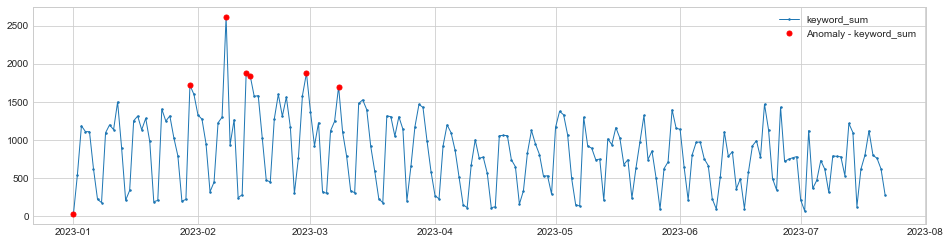

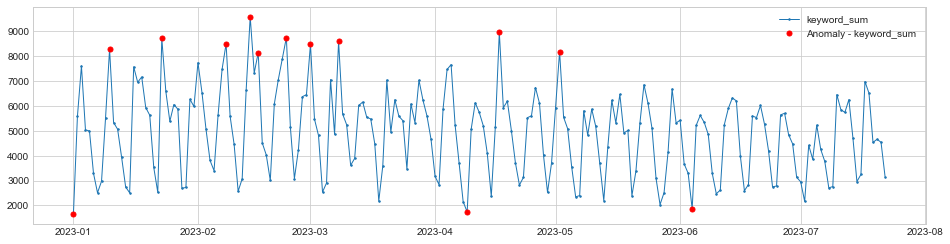

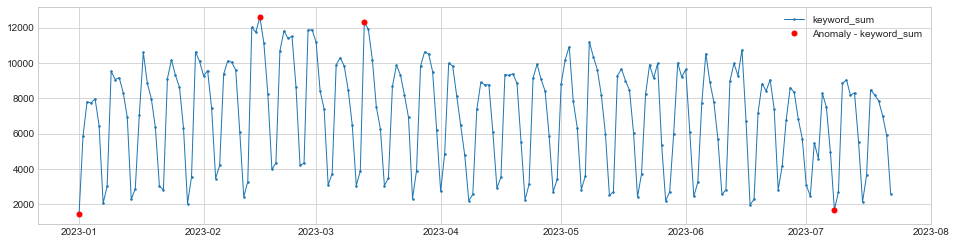

...

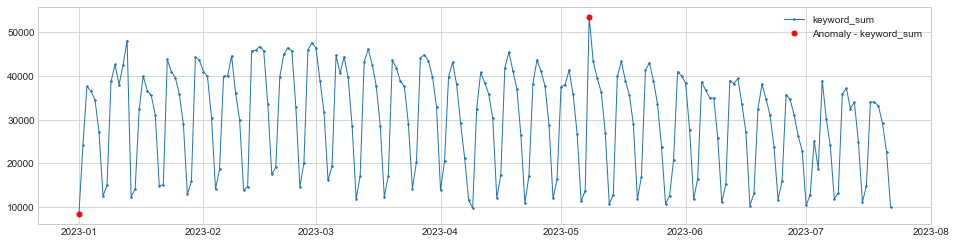

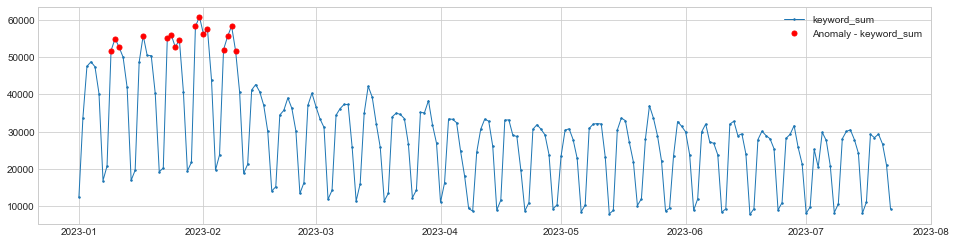

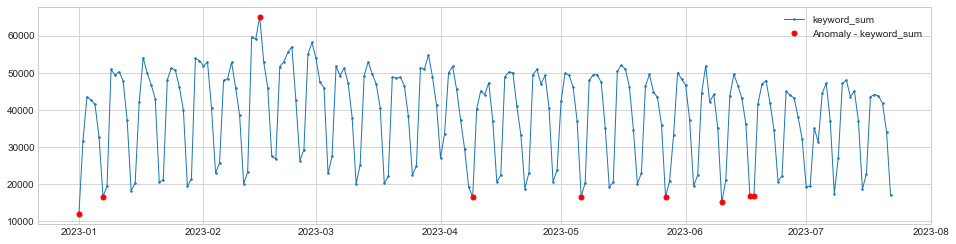

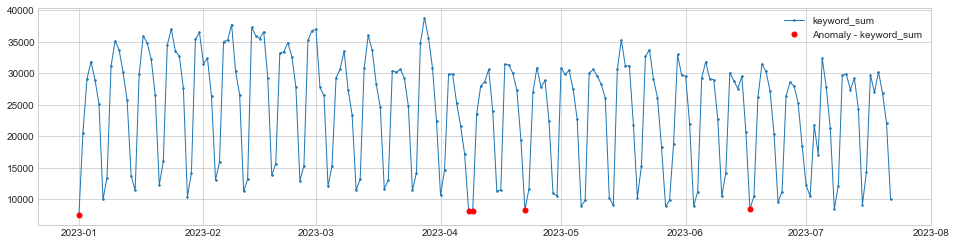

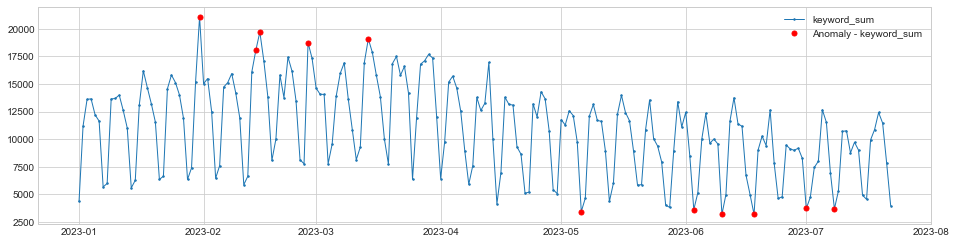

In [23]:
for new_df in df_list:
    df = new_df["keyword_sum"]
    df = pd.DataFrame(df)
    mean = df['keyword_sum'].mean()
    std = df['keyword_sum'].std()

    upper_control_limit = mean + 1.75* std
    lower_control_limit = mean - 1.75 * std
    threshold_ad = ThresholdAD(high=upper_control_limit, low=lower_control_limit)
    anomalies = threshold_ad.detect(df)
    anomalies_threshold.append(anomalies)
    plot(df, anomaly=anomalies, ts_linewidth=1, ts_markersize=3, anomaly_markersize=5, anomaly_color='red', anomaly_tag="marker");


In [24]:
len(anomalies_threshold)

34

#### Seasonal

In [25]:
from adtk.detector import SeasonalAD

In [26]:
anomalies_seasonal = []

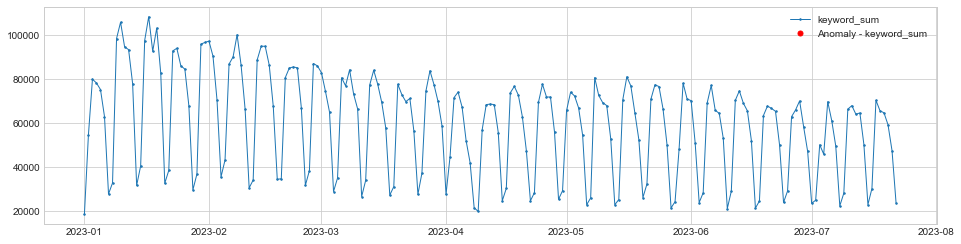

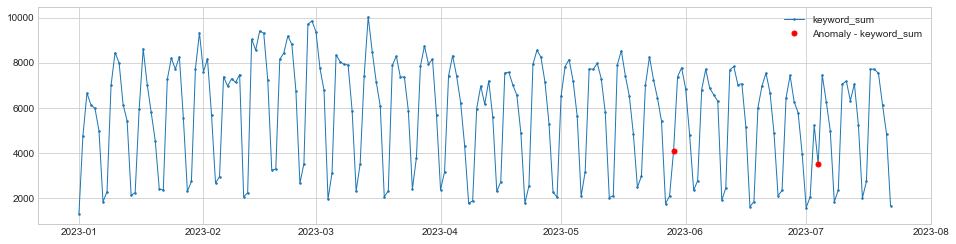

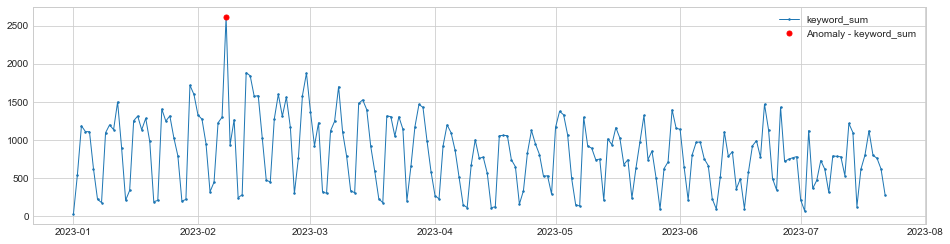

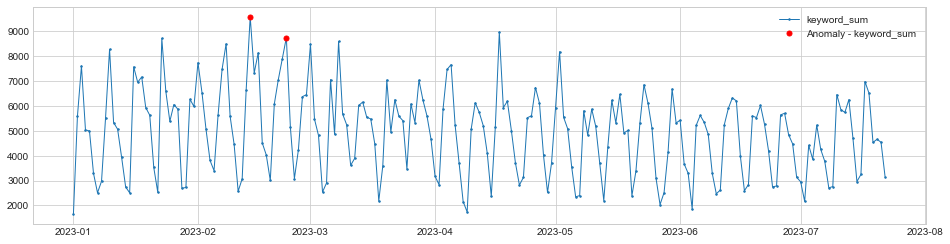

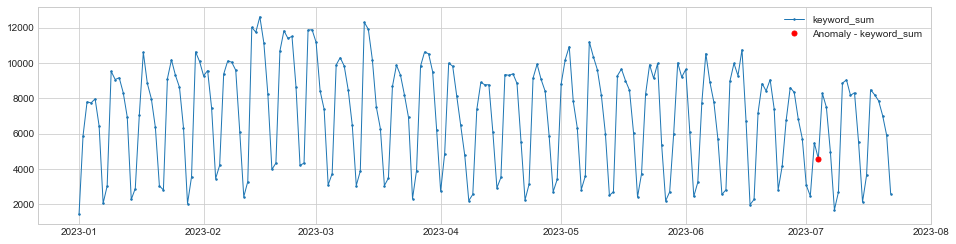

...

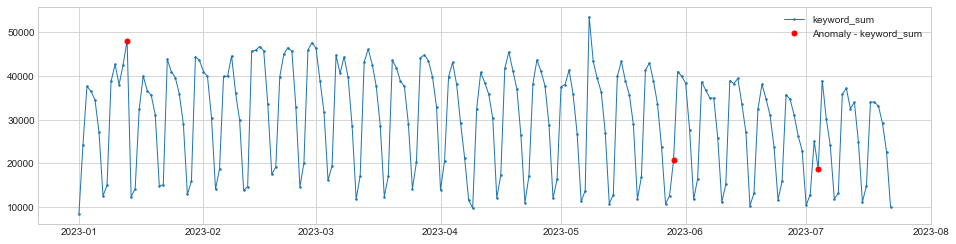

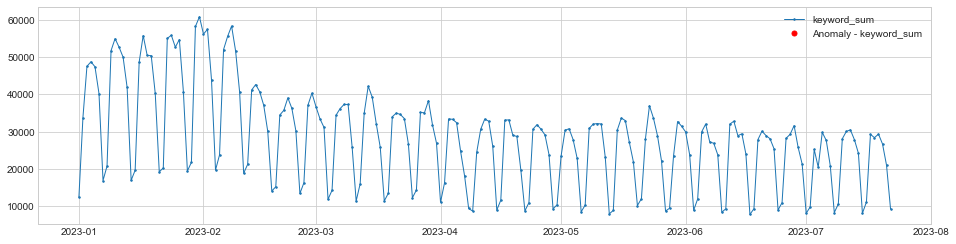

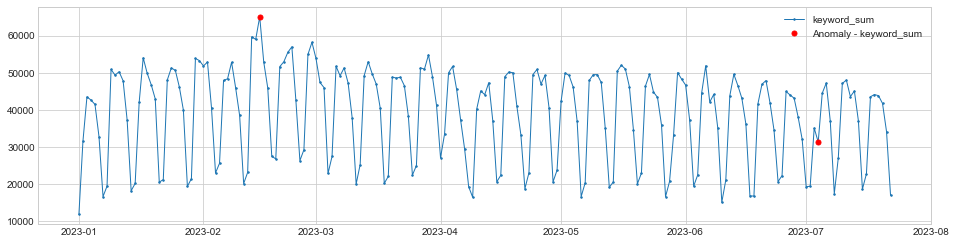

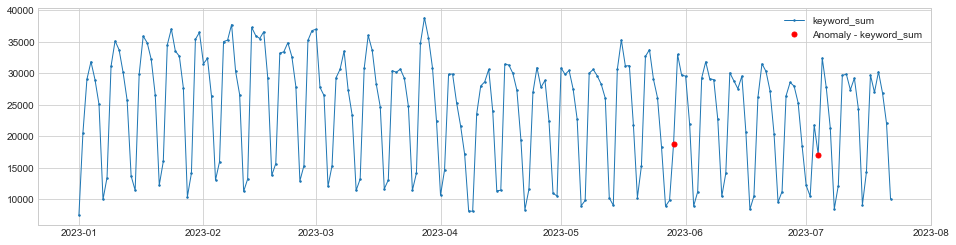

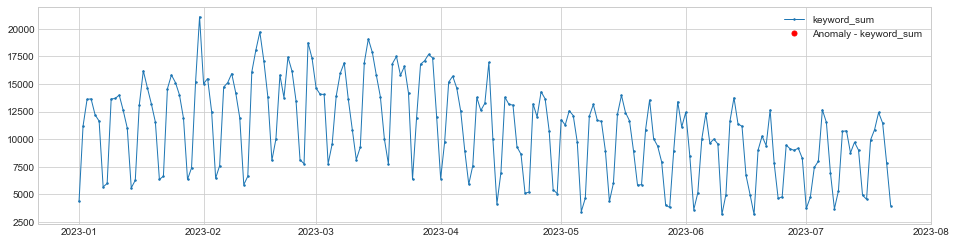

In [27]:
for new_df in df_list:
    df = new_df["keyword_sum"]
    df = pd.DataFrame(df)
    
    seasonal_ad = SeasonalAD()
    anomalies = seasonal_ad.fit_detect(df)
    anomalies_seasonal.append(anomalies)
    plot(df, anomaly=anomalies, ts_linewidth=1, ts_markersize=3, anomaly_markersize=5, anomaly_color='red', anomaly_tag="marker");

In [28]:
len(anomalies_seasonal)

34

#### Quantile

In [29]:
from adtk.detector import QuantileAD

In [30]:
anomalies_quantile = []

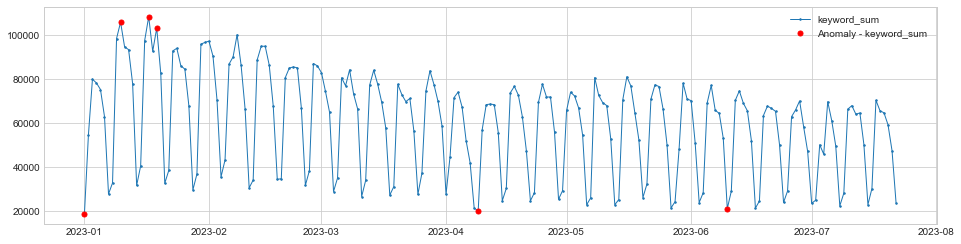

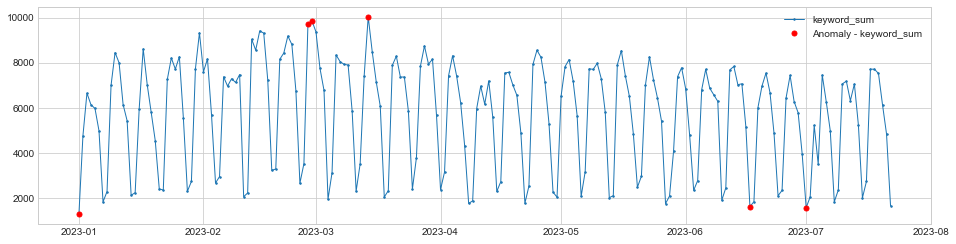

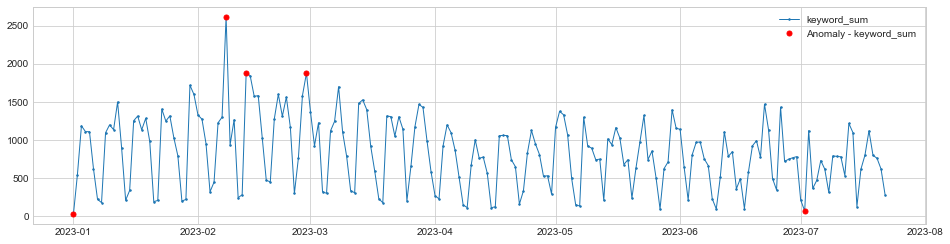

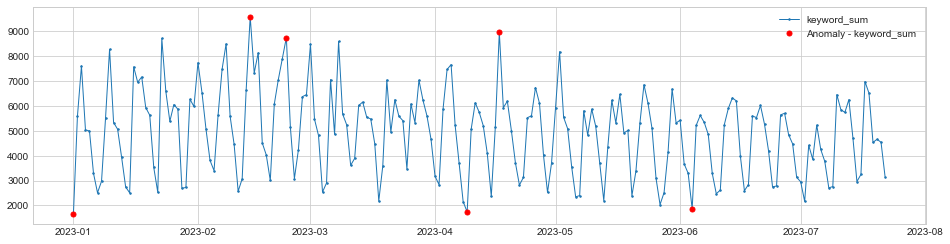

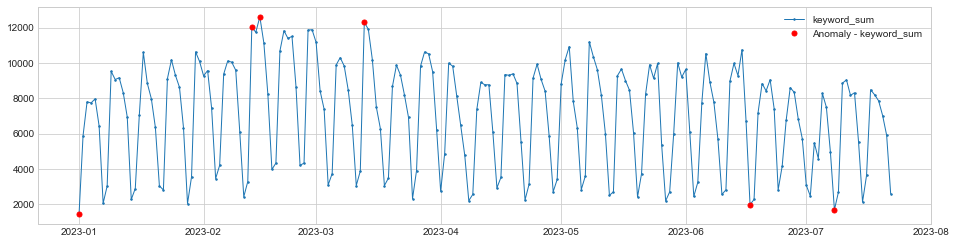

...

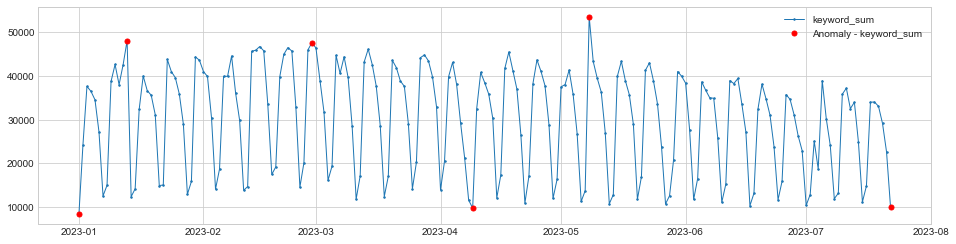

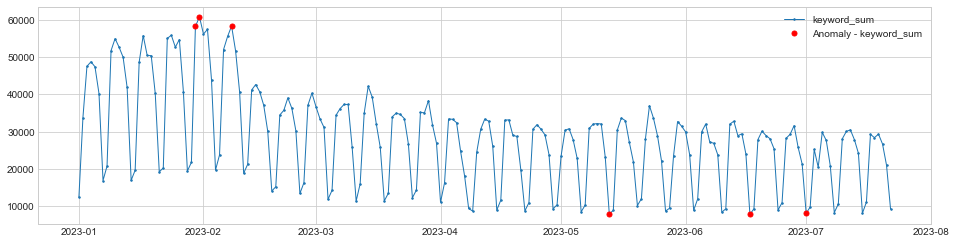

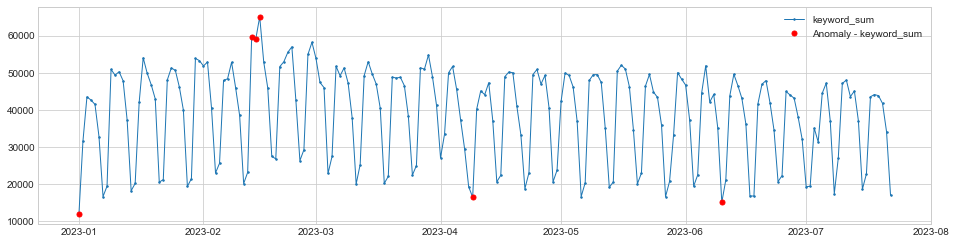

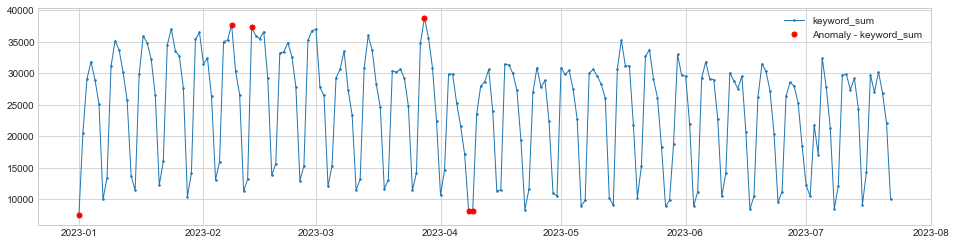

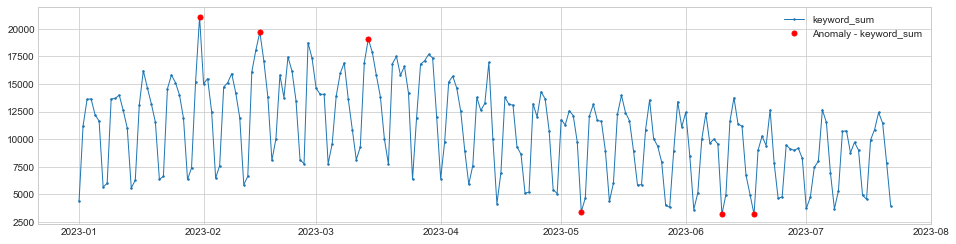

In [31]:
for new_df in df_list:
    df = new_df["keyword_sum"]
    df = pd.DataFrame(df)
    
    quantile_ad = QuantileAD(high=0.99, low=0.01)
    anomalies = quantile_ad.fit_detect(df)
    anomalies_quantile.append(anomalies)
    plot(df, anomaly=anomalies, ts_linewidth=1, ts_markersize=3, anomaly_markersize=5, anomaly_color='red', anomaly_tag="marker");

In [32]:
len(anomalies_quantile)

34

### THRESHOLD + SEASONAL + QUANTILE PLOTS

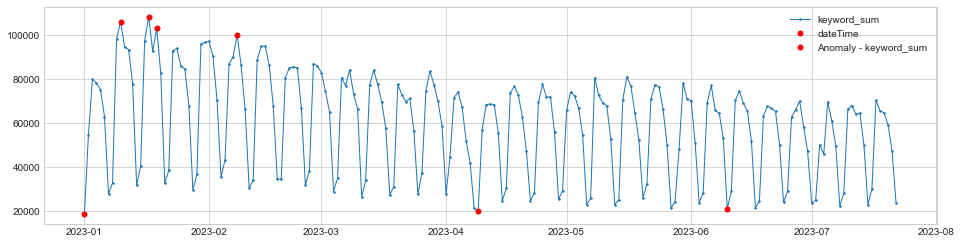

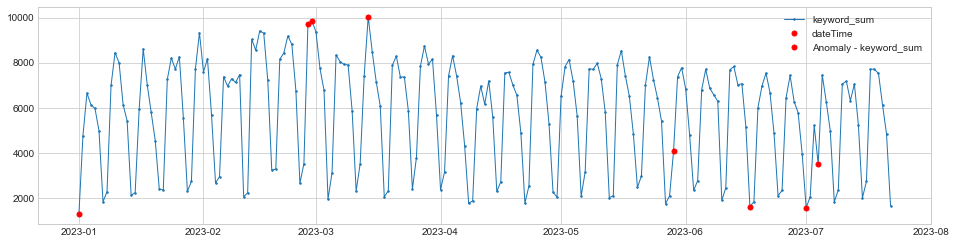

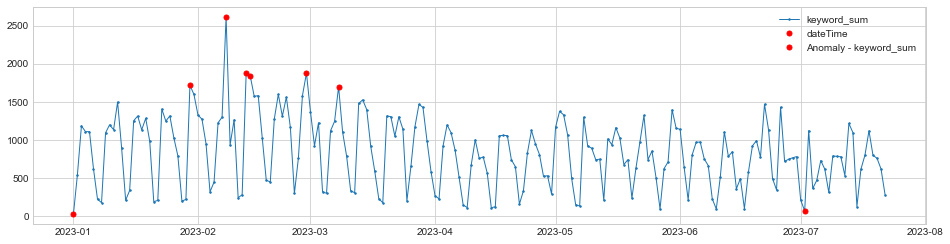

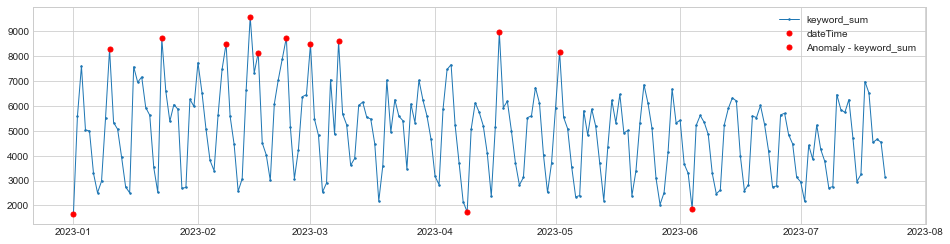

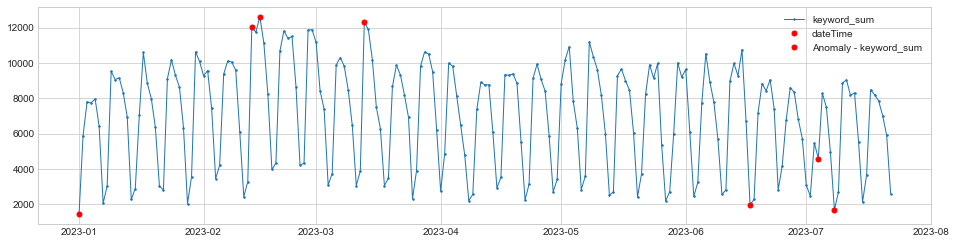

...

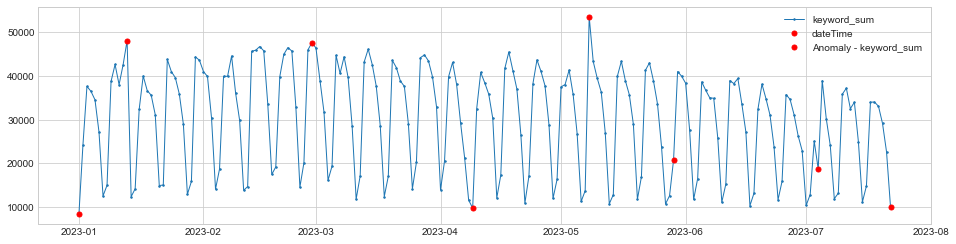

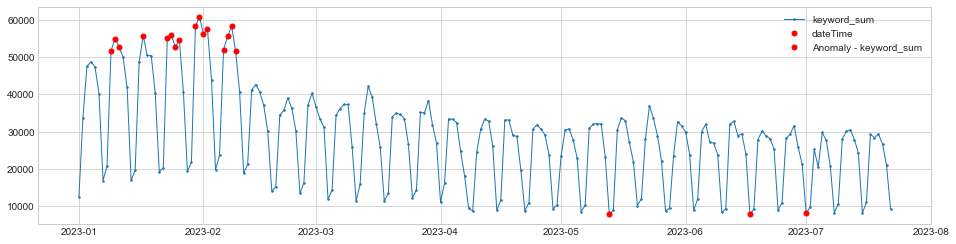

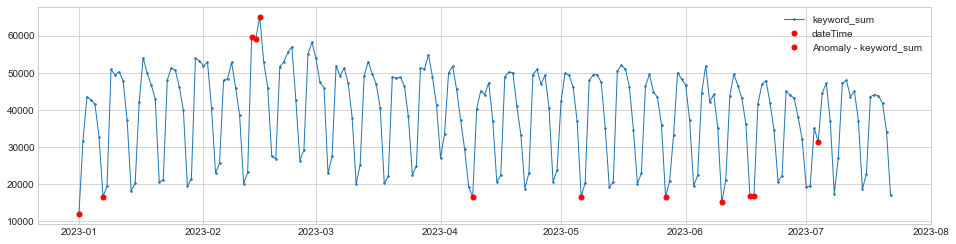

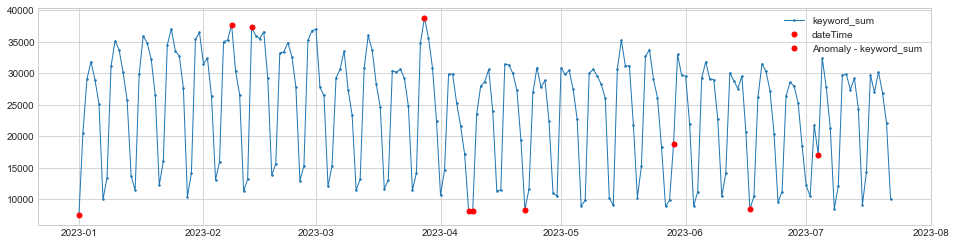

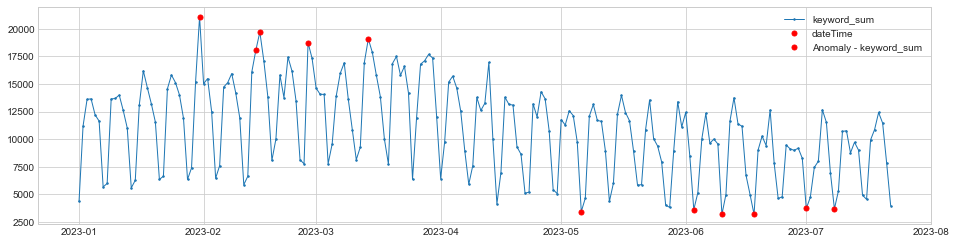

In [33]:
for i in range(0,34):
    df = df_list[i]
    a_t = anomalies_threshold[i]
    a_s = anomalies_seasonal[i]
    a_q = anomalies_quantile[i]

    df.loc[:,'anomaly'] = False
    count = 0
    for index, row in df.iterrows():
        t = a_t.loc[index, 'keyword_sum']
        s = a_s.loc[index, 'keyword_sum']
        q = a_q.loc[index, 'keyword_sum']
        anomaly_value = t or s or q
        if anomaly_value:
            count += 1
        df.at[index, 'anomaly'] = anomaly_value

    df["dateTime"] = df.index

    anomalies = pd.DataFrame(df.loc[:,["dateTime","anomaly"]])
    anomalies["dateTime"]= pd.to_datetime(anomalies["dateTime"])
    anomalies.rename(columns={'anomaly': 'keyword_sum'}, inplace=True)
    anomalies['keyword_sum'] = anomalies['keyword_sum'].astype(bool)

    plot(df.loc[:,"keyword_sum"], anomaly=anomalies, ts_linewidth=1, ts_markersize=3, anomaly_markersize=5, anomaly_color='red', anomaly_tag="marker");

## Isolation Forest

In [34]:
from sklearn.ensemble import IsolationForest
from sklearn import preprocessing

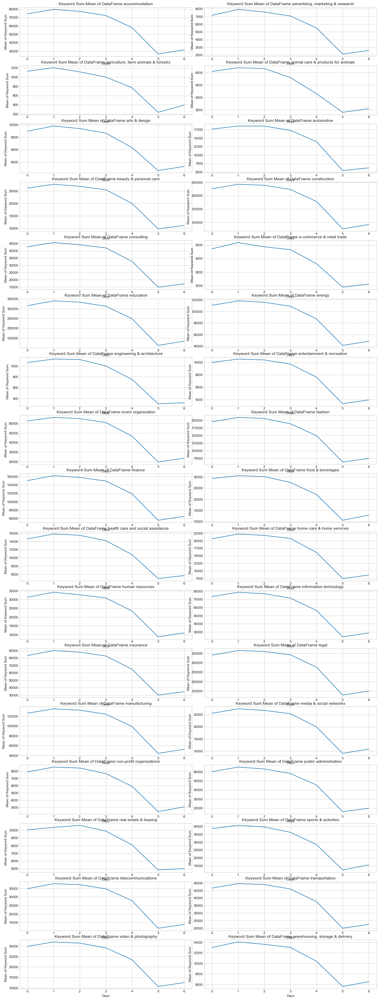

In [46]:
fig, axs = plt.subplots(17, 2, figsize=(15, 40))
fig.tight_layout()

for i, ax_row in enumerate(axs):
    for j, ax in enumerate(ax_row):
        index = i * 2 + j
        if index < len(df_list):
            df = df_list[index]
            ax.plot(df[["keyword_sum", "DayOfTheWeek"]].groupby('DayOfTheWeek').mean())
            ax.set_xlabel('Days')
            ax.set_ylabel('Mean of Keyword Sum')

            cluster = df["cluster"].unique()
            ax.set_title(f'Keyword Sum Mean of DataFrame {cluster[0]}')
            
        else:
            ax.axis('off')  # Eğer dataframe kalmadıysa, bu hücreyi boş bırak

plt.show()

In [36]:
outliers_fraction = 0.01

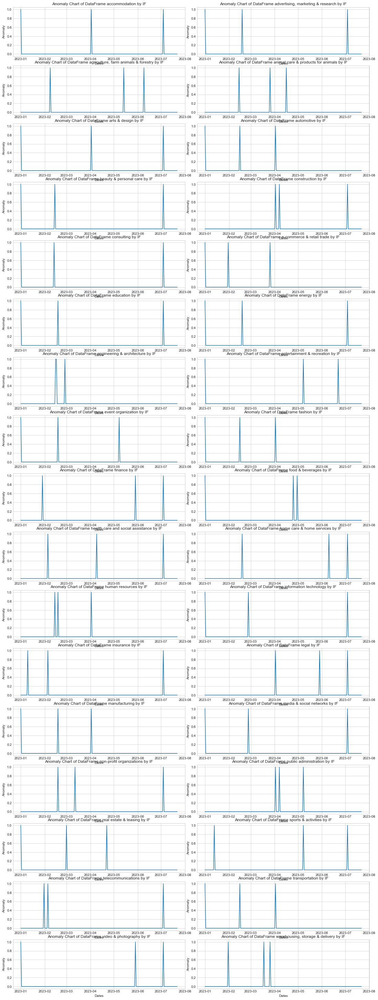

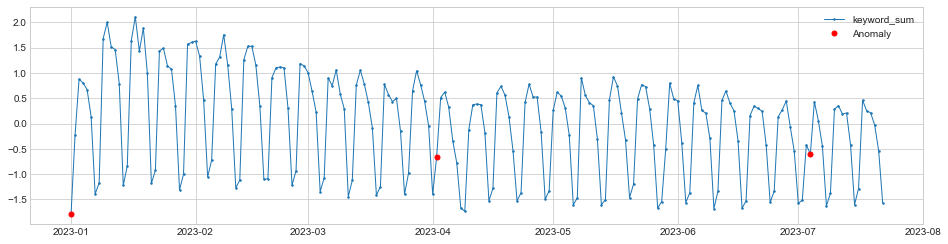

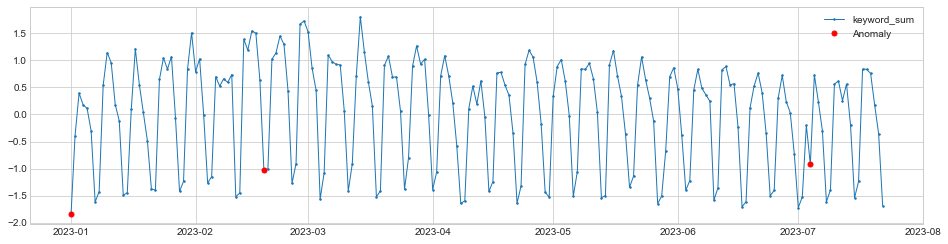

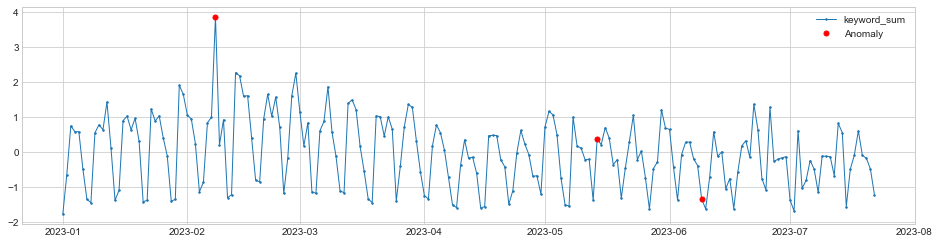

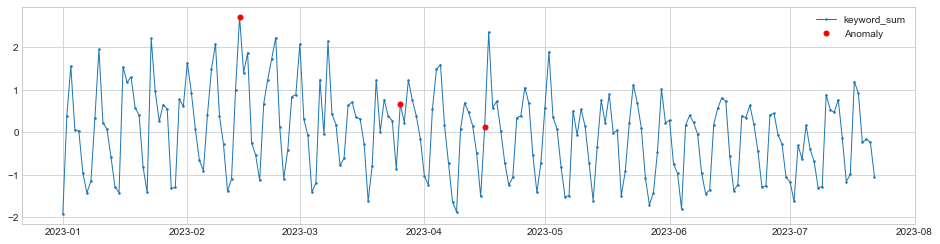

...

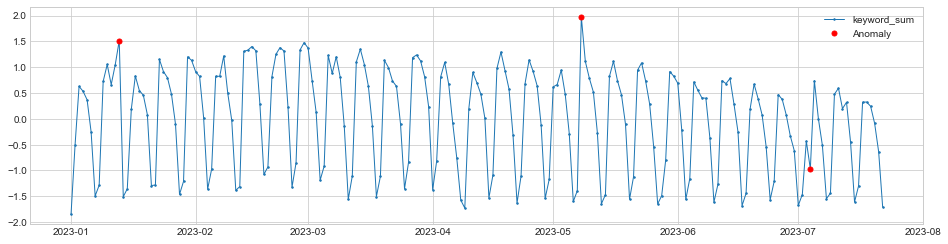

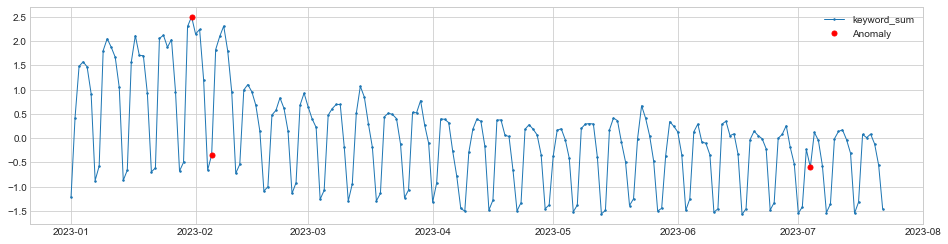

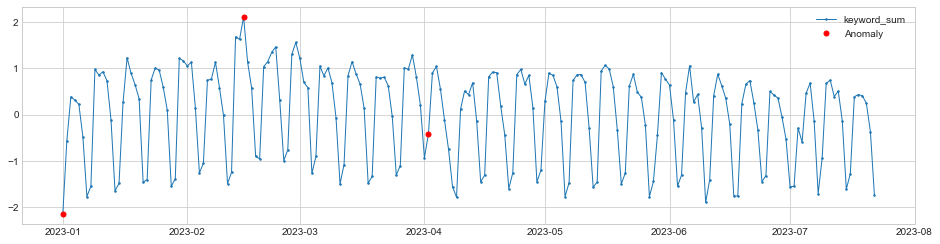

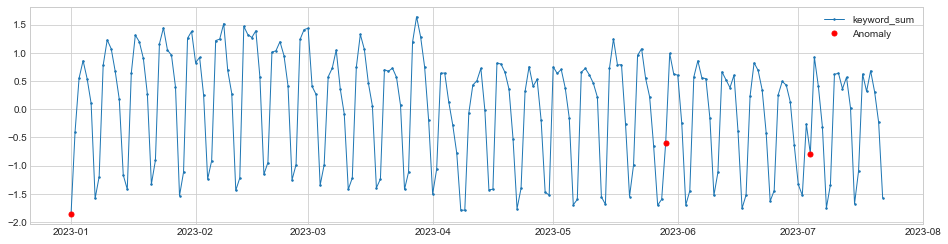

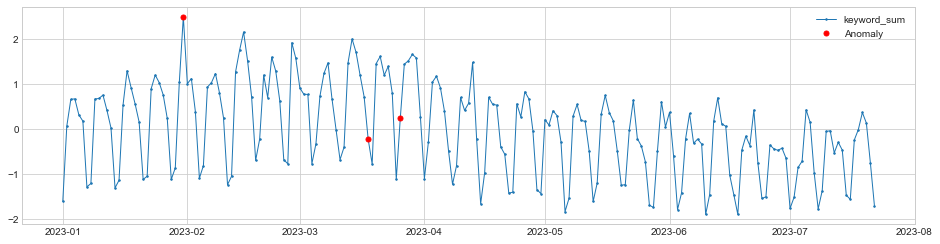

In [37]:
fig, axs = plt.subplots(17, 2, figsize=(15, 40))
fig.tight_layout()

for i, ax_row in enumerate(axs):
    for j, ax in enumerate(ax_row):
        index = i * 2 + j
        if index < len(df_list):
            df = df_list[index]
            n_df = df
            n_df["dateTime"] = n_df.index
            data = n_df[['keyword_sum', 'DayOfTheWeek', 'WeekDay']]
            data.reset_index(drop=True, inplace=True)
            data = pd.DataFrame(data)
            min_max_scaler = preprocessing.StandardScaler()

            scaled_data = min_max_scaler.fit_transform(data)
            scaled_df = pd.DataFrame(scaled_data, columns=data.columns, index=data.index)
            data = pd.DataFrame(scaled_df)
            model =  IsolationForest(contamination = outliers_fraction)
            model.fit(data)
            data["anomaly25"] = pd.DataFrame(model.predict(data))

            data["anomaly25"] = data["anomaly25"].map( {1: 0, -1: 1}) 
            data.set_index(n_df['dateTime'], inplace=True)
            ax.plot(data["anomaly25"])
            ax.set_xlabel('Dates')
            ax.set_ylabel('Anomaly')
            cluster = df["cluster"].unique()
            ax.set_title(f'Anomaly Chart of DataFrame {cluster[0]} by IF')
            plot(data.loc[:,"keyword_sum"], anomaly=data.loc[:,"anomaly25"], ts_linewidth=1, ts_markersize=3, anomaly_markersize=5, anomaly_color='red', anomaly_tag="marker");
            
            
        else:
            ax.axis('off')  # Eğer dataframe kalmadıysa, bu hücreyi boş bırak

plt.show();

### GAUSSIAN

In [38]:
from sklearn.covariance import EllipticEnvelope

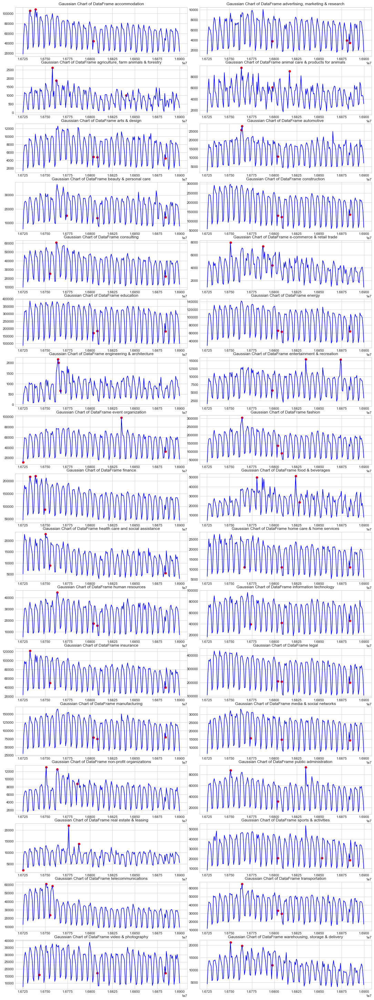

In [39]:
fig, axs = plt.subplots(17, 2, figsize=(15, 40))
fig.tight_layout()

for i, ax_row in enumerate(axs):
    for j, ax in enumerate(ax_row):
        index = i * 2 + j
        if index < len(df_list):
            df = df_list[index]
            n_df = df

            df_class0 = n_df.loc[n_df['WeekDay'] == 0, 'keyword_sum'] #weekend
            df_class1 = n_df.loc[n_df['WeekDay'] == 1, 'keyword_sum'] #weekday

            envelope =  EllipticEnvelope(contamination = outliers_fraction) 
            X_train = df_class0.values.reshape(-1,1)
            envelope.fit(X_train)
            df_class0 = pd.DataFrame(df_class0)
            df_class0['deviation'] = envelope.decision_function(X_train)
            df_class0['anomaly'] = envelope.predict(X_train)

            envelope =  EllipticEnvelope(contamination = outliers_fraction) 
            X_train = df_class1.values.reshape(-1,1)
            envelope.fit(X_train)
            df_class1 = pd.DataFrame(df_class1)
            df_class1['deviation'] = envelope.decision_function(X_train)
            df_class1['anomaly'] = envelope.predict(X_train)

            df_class = pd.concat([df_class0, df_class1])
            n_df['anomaly'] = df_class['anomaly']
            n_df['anomaly'] = np.array(n_df['anomaly'] == -1).astype(int) 

            a = n_df.loc[n_df['anomaly'] == 1, ('time_epoch', 'keyword_sum')] #anomaly

            ax.plot(n_df['time_epoch'], n_df['keyword_sum'], color='blue')
            ax.scatter(a['time_epoch'],a['keyword_sum'], color='red')
            cluster = n_df["cluster"].unique()
            ax.set_title(f'Gaussian Chart of DataFrame {cluster[0]}')
            
        else:
            ax.axis('off')  # Eğer dataframe kalmadıysa, bu hücreyi boş bırak

plt.show();

### MARKOV CHAIN

In [40]:
def anomalyElement(sequence, threshold, transition_matrix):
    if (sucessScore(sequence, transition_matrix) > threshold):
        return 0
    else:
        return 1


def successProbabilityMetric(state1, state2, transition_matrix):
    proba = 0
    for k in range(0, len(transition_matrix)):
        if (k != (state2-1)):
            proba += transition_matrix[state1-1][k]
    return 1-proba

# return the success probability of the whole sequence


def sucessScore(sequence, transition_matrix):
    proba = 0
    for i in range(1, len(sequence)):
        if (i == 1):
            proba = successProbabilityMetric(
                sequence[i-1], sequence[i], transition_matrix)
        else:
            proba = proba * \
                successProbabilityMetric(
                    sequence[i-1], sequence[i], transition_matrix)
    return proba

def getTransitionMatrix(df):
    transitions = np.array(df)
    n = 1+ max(transitions) #number of states

    M = [[0]*n for _ in range(n)]

    for (i,j) in zip(transitions,transitions[1:]):
        M[i][j] += 1

    #now convert to probabilities:
    for row in M:
        s = sum(row)
        if s > 0:
            row[:] = [f/s for f in row]
    return M    

def markovAnomaly(df, windows_size, threshold):
    transition_matrix = getTransitionMatrix(df)
    real_threshold = threshold**windows_size
    df_anomaly = []
    for j in range(0, len(df)):
        if (j < windows_size):
            df_anomaly.append(0)
        else:
            sequence = df[j-windows_size:j]
            sequence = sequence.reset_index(drop=True)
            df_anomaly.append(anomalyElement(
                sequence, real_threshold, transition_matrix))
    return df_anomaly


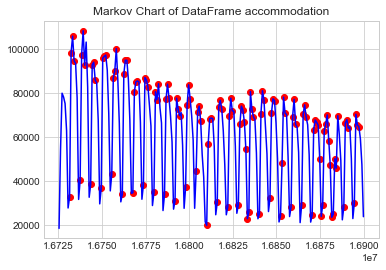

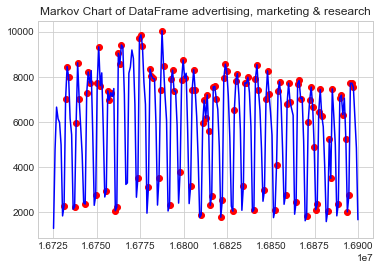

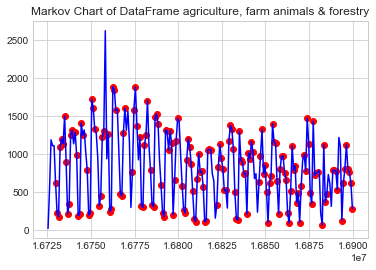

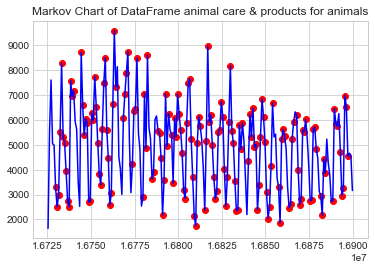

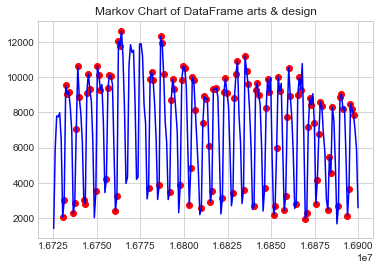

...

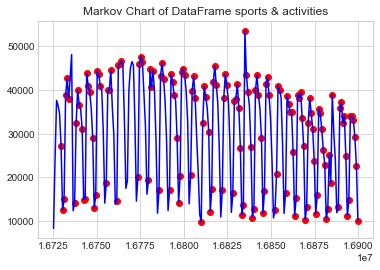

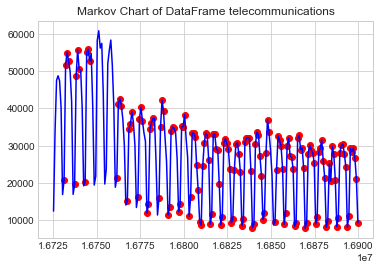

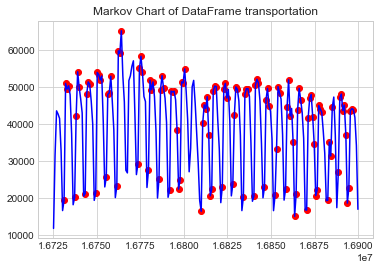

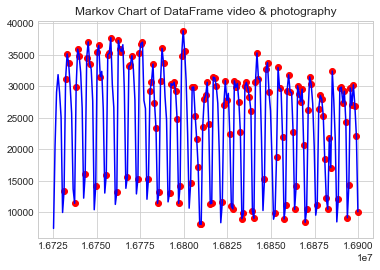

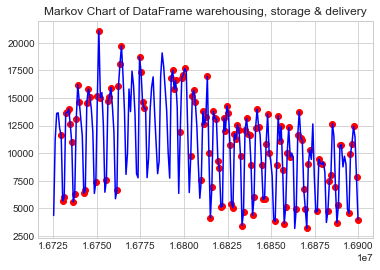

In [41]:
for df in df_list:
    n_df = df

    percentile_25 = n_df.keyword_sum.quantile(0.25)
    mean = n_df.keyword_sum.mean()
    median = n_df.keyword_sum.median()
    percentile_75 = n_df.keyword_sum.quantile(0.75)

    x1 = (n_df['keyword_sum'] <=percentile_25).astype(int)
    x2= ((n_df['keyword_sum'] > percentile_25) & (n_df['keyword_sum']<=mean)).astype(int)
    x3 = ((n_df['keyword_sum'] > mean) & (n_df['keyword_sum']<=median)).astype(int)
    x4 = ((n_df['keyword_sum'] > median) & (n_df['keyword_sum']<=percentile_75)).astype(int)
    x5 = (n_df['keyword_sum'] >percentile_75).astype(int)
    df_mm = x1 + 2*x2 + 3*x3 + 4*x4 + 5*x5

    # getting the anomaly labels for our dataset (evaluating sequence of 5 values and anomaly = less than 20% probable)
    df_anomaly = markovAnomaly(df_mm, 5, 0.20)
    df_anomaly = pd.Series(df_anomaly)
    cluster = n_df["cluster"].unique()

    n_df['anomaly'] = df_anomaly.values

    fig, ax = plt.subplots()

    a = n_df.loc[n_df['anomaly'] == 1, ('time_epoch', 'keyword_sum')] #anomaly

    ax.plot(n_df['time_epoch'], n_df['keyword_sum'], color='blue')
    ax.scatter(a['time_epoch'],a['keyword_sum'], color='red') 
    ax.set_title(f'Markov Chart of DataFrame {cluster[0]}')
    plt.show()
else:
    ax.axis('off')  # Eğer dataframe kalmadıysa, bu hücreyi boş bırak

#plt.show();

### CLUSTER

In [42]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

In [43]:
def getDistanceByPoint(data, model):
    distance = pd.Series()
    for i in range(0, len(data)):
        Xa = np.array(data.loc[i])
        Xb = model.cluster_centers_[model.labels_[i]-1]
        distance.at[i] = np.linalg.norm(Xa - Xb)
    return distance

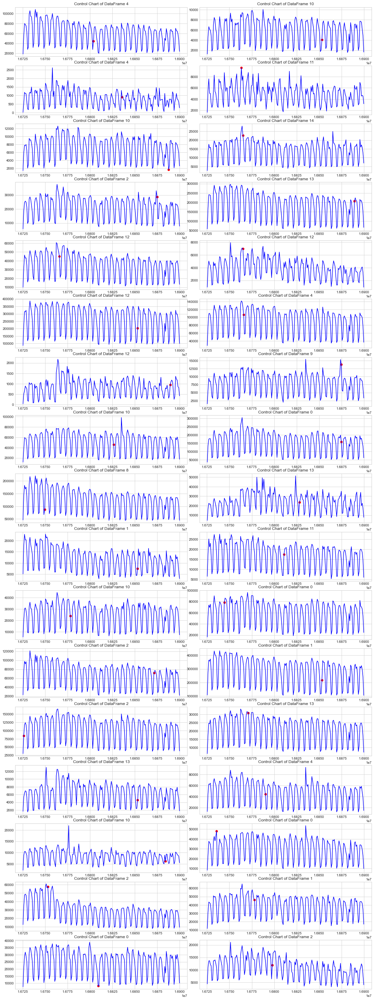

In [44]:
fig, axs = plt.subplots(17, 2, figsize=(15, 40))
fig.tight_layout()

for i, ax_row in enumerate(axs):
    for j, ax in enumerate(ax_row):
        index = i * 2 + j
        if index < len(updated_df_list):
            df = updated_df_list[index]
            n_df = df
            # Take useful feature and standardize them
            data = n_df[['keyword_sum', 'DayOfTheWeek', 'WeekDay']]
            min_max_scaler = preprocessing.StandardScaler()
            np_scaled = min_max_scaler.fit_transform(data)
            data = pd.DataFrame(np_scaled)
            # reduce to 2 importants features
            pca = PCA(n_components=2)
            data = pca.fit_transform(data)
            # standardize these 2 new features
            min_max_scaler = preprocessing.StandardScaler()
            np_scaled = min_max_scaler.fit_transform(data)
            data = pd.DataFrame(np_scaled)

            # calculate with different number of centroids to see the loss plot (elbow method)
            n_cluster = range(1, 20)
            kmeans = [KMeans(n_clusters=i).fit(data) for i in n_cluster]
            scores = [kmeans[i].score(data) for i in range(len(kmeans))]

            n_df['cluster'] = kmeans[14].predict(data)
            n_df['principal_feature1'] = data[0]
            n_df['principal_feature2'] = data[1]
            n_df['cluster'].value_counts()

            # get the distance between each point and its nearest centroid. The biggest distances are considered as anomaly
            distance = getDistanceByPoint(data, kmeans[14])
            number_of_outliers = int(outliers_fraction*len(distance))
            threshold = distance.nlargest(number_of_outliers).min()
            anomaly = (distance <= threshold).astype(int)
            anomaly = pd.Series(anomaly)
            cluster = n_df["cluster"].unique()

            n_df['anomaly'] = anomaly.values
            n_df['anomaly'] = n_df['anomaly'].fillna(0)
            a = n_df.loc[n_df['anomaly'] == 0, ['time_epoch', 'keyword_sum']] #anomaly

            ax.plot(n_df['time_epoch'], n_df['keyword_sum'], color='blue')
            ax.scatter(a['time_epoch'],a['keyword_sum'], color='red')
            cluster = df["cluster"].unique()
            ax.set_title(f'Control Chart of DataFrame {cluster[0]}')

        else:
            ax.axis('off')  # Eğer dataframe kalmadıysa, bu hücreyi boş bırak

plt.show()

The best result is adtk.